# **UCI ML Drug Review Analysis**



The UCI ML Drug Review dataset provides patient reviews on specific drugs along with related conditions and a 10-star patient rating system reflecting overall patient satisfaction. The data was obtained by crawling online pharmaceutical review sites. This data was published in a study on sentiment analysis of drug experience over multiple facets, ex. sentiments learned on specific aspects such as effectiveness and side effects.

Lets initially begin with analyzing the dataset, and then further formulate the problem statement

In [170]:
# !pwd

In [171]:
# https://www.kaggle.com/datasets/jessicali9530/kuc-hackathon-winter-2018

In [172]:
# import kaggle

# kaggle.api.dataset_download_files('jessicali9530/kuc-hackathon-winter-2018', path='/Projects', unzip=True)

In [173]:
# %cd ..
# %pwd


In [174]:
# !mv -v drugsComTest_raw.csv drugsComTrain_raw.csv /Projects

In [175]:
# %cd /Projects
# !pwd

In [176]:
import pandas as pd 

df = pd.read_csv("/Projects/drugsComTrain_raw.csv")
df

,uniqueID,drugName,condition,review,rating,date,usefulCount
0,206461,Valsartan,Left Ventricular Dysfunction,"""It has no side effect, I take it in combinati...",9,20-May-12,27
1,95260,Guanfacine,ADHD,"""My son is halfway through his fourth week of ...",8,27-Apr-10,192
2,92703,Lybrel,Birth Control,"""I used to take another oral contraceptive, wh...",5,14-Dec-09,17
3,138000,Ortho Evra,Birth Control,"""This is my first time using any form of birth...",8,3-Nov-15,10
4,35696,Buprenorphine / naloxone,Opiate Dependence,"""Suboxone has completely turned my life around...",9,27-Nov-16,37
...,...,...,...,...,...,...,...
161292,191035,Campral,Alcohol Dependence,"""I wrote my first report in Mid-October of 201...",10,31-May-15,125
161293,127085,Metoclopramide,Nausea/Vomiting,"""I was given this in IV before surgey. I immed...",1,1-Nov-11,34
161294,187382,Orencia,Rheumatoid Arthritis,"""Limited improvement after 4 months, developed...",2,15-Mar-14,35
161295,47128,Thyroid desiccated,Underactive Thyroid,"""I&#039;ve been on thyroid medication 49 years...",10,19-Sep-15,79


In [177]:
#Check data information such as column names and data types.
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 161297 entries, 0 to 161296
Data columns (total 7 columns):
 #   Column       Non-Null Count   Dtype 
---  ------       --------------   ----- 
 0   uniqueID     161297 non-null  int64 
 1   drugName     161297 non-null  object
 2   condition    160398 non-null  object
 3   review       161297 non-null  object
 4   rating       161297 non-null  int64 
 5   date         161297 non-null  object
 6   usefulCount  161297 non-null  int64 
dtypes: int64(3), object(4)
memory usage: 8.6+ MB


In [178]:
# Changing the data column data type to datetime type 
df['date'] = pd.to_datetime(df['date'])

/var/folders/qf/skvw9ygx6hnddqy1kk2pswtc0000gn/T/ipykernel_33471/218707336.py:2: UserWarning:

Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.



In [179]:
df.dtypes

uniqueID                int64
drugName               object
condition              object
review                 object
rating                  int64
date           datetime64[ns]
usefulCount             int64
dtype: object

In [180]:
# Drop the uniqueID column as it does not provide any useful information in the analysis
df = df.drop(columns=['uniqueID'])


In [181]:
# Check the no. of unique values in each column which gives an idea of probable categorical columns.
df.nunique()

drugName         3436
condition         884
review         112329
rating             10
date             3579
usefulCount       389
dtype: int64

In [182]:
# Check the total missing values in each column
df.isna().sum()

drugName         0
condition      899
review           0
rating           0
date             0
usefulCount      0
dtype: int64

In [183]:
# Just experiemnting with different functions
# print(df.isna().sum())
# print(df.isna().mean())
# print(df.count())

In [184]:
# Calculate the percentage of missing values in each column
for col in df:
    print(f'{df[col].isna().mean()*100:.2f}%')

0.00%
0.56%
0.00%
0.00%
0.00%
0.00%


In [185]:
# Checking for duplicate rows
df.duplicated().sum()

0

0.5% of the values in the condition column are missing, and is not significant to drop or impute for now.

In [186]:
# List of numerical columns
num_cols = [col for col in df if df[col].dtype != object and df[col].dtype != 'datetime64[ns]']
# manually checking rating is ordinal categorical column thus we can manually remove it from the list of categorical columns.
num_cols.remove('rating')
num_cols

['usefulCount']

In [187]:
# List of categorical columns
cat_cols  = list(df.select_dtypes(include=object).columns)
cat_cols.remove('review')
# cat_cols.append("rating")
cat_cols

['drugName', 'condition']

In [188]:
# Creating data specific column list for ease of specific visualization ahead. 
# Though not required to create list in this case, as number of columns for each type is singular. Done for good practice.
ordinal_col = ['rating']
text_col = ['review']

In [189]:
# Checking the descriptive statistics of the numerical columns in the data, such as the ratings and usefulcount
df[num_cols].describe()

,usefulCount
count,161297.000000
mean,28.004755
std,36.403742
min,0.000000
25%,6.000000
50%,16.000000
75%,36.000000
max,1291.000000


In [353]:
df

,drugName,condition,review,rating,date,usefulCount
0,Valsartan,Left Ventricular Dysfunction,"""It has no side effect, I take it in combinati...",9,2012-05-20,27
1,Guanfacine,ADHD,"""My son is halfway through his fourth week of ...",8,2010-04-27,192
2,Lybrel,Birth Control,"""I used to take another oral contraceptive, wh...",5,2009-12-14,17
3,Ortho Evra,Birth Control,"""This is my first time using any form of birth...",8,2015-11-03,10
4,Buprenorphine / naloxone,Opiate Dependence,"""Suboxone has completely turned my life around...",9,2016-11-27,37
...,...,...,...,...,...,...
161292,Campral,Alcohol Dependence,"""I wrote my first report in Mid-October of 201...",10,2015-05-31,125
161293,Metoclopramide,Nausea/Vomiting,"""I was given this in IV before surgey. I immed...",1,2011-11-01,34
161294,Orencia,Rheumatoid Arthritis,"""Limited improvement after 4 months, developed...",2,2014-03-15,35
161295,Thyroid desiccated,Underactive Thyroid,"""I&#039;ve been on thyroid medication 49 years...",10,2015-09-19,79


In [354]:
df.to_csv('/Users/yatharth/Documents/RND4IMPACT/Projects/df_review_analysis.csv', index = False)

# **Analyzing Data**

In [191]:
import plotly.express as px

for col in num_cols:
    fig = px.histogram(df, x=col, title=f'Histogram of {col}')
    fig.show()

    fig = px.box(df, x=col, title=f'Box of {col}')
    fig.show()

In [192]:
df['usefulCount'].mean()

28.00475520313459

The histogram of usefulCount clearly showcases right-skewdness indicating extreme values of usefulCount of few drugs pulling the mean(28) to the right. The boxplot clearly indicates the outliers present in the data with the individual points plotted beyond the whiskers as some drugs seem to have higher usefulCount by the reviewers. 

- The median is 16 showcasing the useful count for drugs is quite low, and the middle 50% of the data (Q1-Q3) only has useful counts between 6 and 36. In fact, 75% of the data has a useful count below 36.

**Product Review Insights:**

- Most drugs have modest useful counts, suggesting moderate user engagement.
- A small number of drugs are highly engaged, potentially indicating their effectiveness or popularity among users.

**Marketing and Product Improvement**:

- Understanding which drugs have high useful counts can help in identifying successful products.
- Analyzing the reasons behind high useful counts for certain drugs can provide insights for improving other products.


### Visualizing the categorical columns to understand the distribution of data. Like most used drug and high described condition.

In [193]:
#Visualizing the categorical columns to understand the distribution of data. Like most used drug and high describec condition.
for col in cat_cols:
    fig = px.histogram(df, x=col, title=f'Count of {col}', text_auto=True)
    fig.show()

Due to large amount of value for drugName and condition we can filter and select first few values having high count to get immeidate meaningful insights

In [194]:
# Count occurrences of each condition and sort in descending order
condition_counts = df['condition'].value_counts().reset_index()
condition_counts = condition_counts[0:20]
condition_counts.columns = ['condition', 'count']
condition_counts = condition_counts.sort_values(by='count', ascending=False)

# Create a histogram using Plotly Express
fig = px.bar(condition_counts, x='condition', y='count', title='Top 20 Reviewed Condition', text='count')

# Update layout for better visualization
fig.update_layout(xaxis_title='Condition', yaxis_title='Count', xaxis={'categoryorder':'total descending'})
fig.show()

In [195]:
drug_count = df["drugName"].value_counts().reset_index()
drug_count =  drug_count[:20]
drug_count.columns = ['drug','count']
# drug_count 

drug_count = drug_count.sort_values(by = "count", ascending=False)

# Create a histogram using Plotly Express
fig = px.bar(drug_count, x='drug', y='count', title='Top 20 Reviewed Drugs', text='count')

# Update layout for better visualization
fig.update_layout(xaxis_title='Drug', yaxis_title='Count', xaxis={'categoryorder':'total descending'})
fig.show()

### **Visualizing the Ratings**

In [196]:
for col in ordinal_col:
    fig = px.histogram(df, x=col, title=f'Histogram of {col}', text_auto=True)
    fig.show()
    fig = px.box(df, y=col, title=f'Box Plot of {col}')
    fig.show()

Most of the ratings lie in the right, show casing left skewdness as majority of ratings are on the higher end. The median rating is also 8, confirming that the central tendency of ratings is high for the drugs in the dataset. Thus, we can infer an over all positive satisfactory sentiment from the ratings analysis. 

 - The box represents the middle 50% of the data (from Q1 to Q3), which appears to be from around 6 to 10. This indicates that a significant portion of the ratings are high. (*Since 75% of the ratings are 6 or above, this shows a generally positive sentiment.*)

- The lower whisker extends to around 1, showing the minimum rating. However, the upper whisker and box plot indicate that most ratings are concentrated on the higher end. 
There are no significant outliers, as most of the data points fall within the whiskers, further suggesting consistency in high ratings.

### Average Rating Per Drug

In [197]:
# Just to avoid any changes in the main dataframe while conducting analysis experimentation below:
test_df = df.copy()


Average rating per drug comparison can be misleading as the number of ratings per drugs varies a lot, and for which we can check the distribution of the rating count per drug. We observe from below that the median number of ratings is 5 and goes as high as 3000+ *(Drugs with only a few reviews might have biased or unrepresentative average ratings.)*. Thus, noting this we can formulate the average ratings metric as follows:
- if the number of ratings per drug > 5 then we calculate the average ratings. 
- This helps us focus on the drugs with more representative sampling of ratings and avoid unreliable average ratings. 

Then further for calculating average rating for each drug, the distribution of rating matters for a reliable average metric, thus we can visualize the graph showcasing both mean and median rating.

In [198]:
# test_df.groupby("drugName")['rating'].mean().sort_values(ascending=False)[:30]
rating_count_per_drug = test_df.groupby("drugName")["rating"].count().reset_index()
rating_count_per_drug.columns = ['drug', 'count']
px.box(rating_count_per_drug, x = "count", title = 'Box (Distribution) of Number of Reviews per drug').update_layout(xaxis_title='Rating Count').show()


In [199]:
# Create aggregate functions such as mean, median and count for ratings of each drug
rating_stats_per_drug = test_df.groupby("drugName")["rating"].agg(['mean', 'median', 'count']).reset_index()
rating_stats_per_drug = rating_stats_per_drug[rating_stats_per_drug['count'] >= 5]  # Filter out drugs with fewer than 5 reviews


Using a scatter plot where the x-axis represents the mean rating and the y-axis represents the count of reviews. This can help identify drugs with both high average ratings and a significant number of reviews.

In [200]:
fig = px.scatter(rating_stats_per_drug, x='mean', y='count', hover_data=['drugName'],
                 title='Mean Rating vs. Number of Reviews per Drug', labels={'mean': 'Mean Rating', 'count': 'Number of Reviews'})
fig.show()

In [201]:
import plotly.graph_objects as go

# Create the base figure
fig = go.Figure()


# Add scatter trace for mean
fig.add_trace(go.Scatter(
    x=rating_stats_per_drug['mean'],
    y=rating_stats_per_drug['count'],
    mode='markers',
    name='Mean Rating',
    text=rating_stats_per_drug['drugName'],
    hovertemplate='Drug: %{text}<br>Mean Rating: %{x}<br>Number of Reviews: %{y}<br>Median Rating: %{customdata}',
    marker=dict(color='blue'),
    customdata=rating_stats_per_drug['median']
))

# Add scatter trace for median
fig.add_trace(go.Scatter(
    x=rating_stats_per_drug['median'],
    y=rating_stats_per_drug['count'],
    mode='markers',
    name='Median Rating',
    text=rating_stats_per_drug['drugName'],
    hovertemplate='Drug: %{text}<br>Median Rating: %{x}<br>Number of Reviews: %{y}<br>Mean Rating: %{customdata}',
    marker=dict(color='red'),
    customdata=rating_stats_per_drug['mean']
))

# Update layout
fig.update_layout(
    title='Mean and Median Ratings vs. Number of Reviews per Drug',
    xaxis_title='Rating',
    yaxis_title='Number of Reviews'
)

fig.show()

In [202]:
# Just for fun

# Create the base figure
fig = go.Figure()

# Add 3D scatter trace for mean
fig.add_trace(go.Scatter3d(
    x=rating_stats_per_drug['mean'],
    y=rating_stats_per_drug['count'],
    z=rating_stats_per_drug['median'],
    mode='markers',
    name='Mean Rating',
    text=rating_stats_per_drug['drugName'],
    hovertemplate='Drug: %{text}<br>Mean Rating: %{x}<br>Number of Reviews: %{y}<br>Median Rating: %{z}',
    marker=dict(color='blue', size=5)
))

# Add 3D scatter trace for median
fig.add_trace(go.Scatter3d(
    x=rating_stats_per_drug['median'],
    y=rating_stats_per_drug['count'],
    z=rating_stats_per_drug['mean'],
    mode='markers',
    name='Median Rating',
    text=rating_stats_per_drug['drugName'],
    hovertemplate='Drug: %{text}<br>Median Rating: %{x}<br>Number of Reviews: %{y}<br>Mean Rating: %{z}',
    marker=dict(color='red', size=5)
))

# Update layout
fig.update_layout(
    title='Mean and Median Ratings vs. Number of Reviews per Drug (3D)',
    scene=dict(
        xaxis_title='Avg. Rating',
        yaxis_title='Number of Reviews',
        zaxis_title='Median Rating'
    )
,
    width=1200,  # Increase the width of the figure
    height=800   # Increase the height of the figure
)


fig.show()


In [203]:
# Sort by mean rating and select top 20 drugs
top_20_drugs = rating_stats_per_drug.sort_values(by='mean', ascending=False).reset_index(drop = True).head(20)
top_20_drugs




,drugName,mean,median,count
0,Bazedoxifene / conjugated estrogens,10.000000,10.0,5
1,Nizatidine,10.000000,10.0,5
2,Astelin,10.000000,10.0,9
3,Acetaminophen / pseudoephedrine,10.000000,10.0,7
4,Zinc oxide,10.000000,10.0,8
5,Chlorpheniramine / hydrocodone / pseudoephedrine,10.000000,10.0,11
6,Alprazolam Intensol,10.000000,10.0,5
7,Chlorpheniramine / phenylephrine,10.000000,10.0,6
8,Migergot,10.000000,10.0,5
9,Zutripro,10.000000,10.0,11


In [204]:
review_count= test_df['review'].value_counts().reset_index()
review_count = review_count[review_count['count'] > 1]

In [205]:
# test_df.isin(test_df["review"])
# test_df[test_df['review'] == review_count['review']]

In [206]:
fig = px.scatter(df, x='rating', y='usefulCount', hover_data=['drugName'], trendline="ols",
                 title='Rating vs. UsefulCount', labels={'rating': 'Rating', 'usefulCount': 'UsefulCount'})
fig.show()

## Analyzing Drug Reviews

Step-by-Step Plan

- Initial Word Cloud with Collocations:

        Goal: Visualize common words and bigrams in the review text.
        Method: Use the word frequency from the WordCloud generator with collocations=True.
        Preprocessing: Basic preprocessing and lemmatization using SpaCy.
        Output: A word cloud showing both frequent words and bigrams.

- TF-IDF Based Word Cloud:

        Goal: Highlight the most important words according to their TF-IDF scores.
        Method: Calculate TF-IDF on the preprocessed reviews (prep_review_pipe).
        Collocations: Not applicable, as TF-IDF scores are calculated for individual words.
        Stop Words: Remove stop words to focus on meaningful words.
        Output: A word cloud showing words with high TF-IDF scores.

- Refined TF-IDF Based Word Cloud with POS Tag Removal:

        Goal: Further refine the text by removing insignificant POS tags.
        Method: Apply POS tag removal in the SpaCy pipeline and calculate TF-IDF on the resulting text (custom_prep_review_pos).
        Output: A more meaningful TF-IDF based word cloud.

- Bigram-Based TF-IDF Word Cloud:

        Goal: Generate insights from word pairs (bigrams) rather than individual words.
        Method: Create bigrams from the preprocessed text and calculate TF-IDF scores for these bigrams.
        Stop Words: Avoid removing stop words for bigrams to preserve context.
        Output: A word cloud showing important bigrams.

### Plain Vanilla Word Cloud Generation *(without any preprocessing, just ferequency based word cloud)*

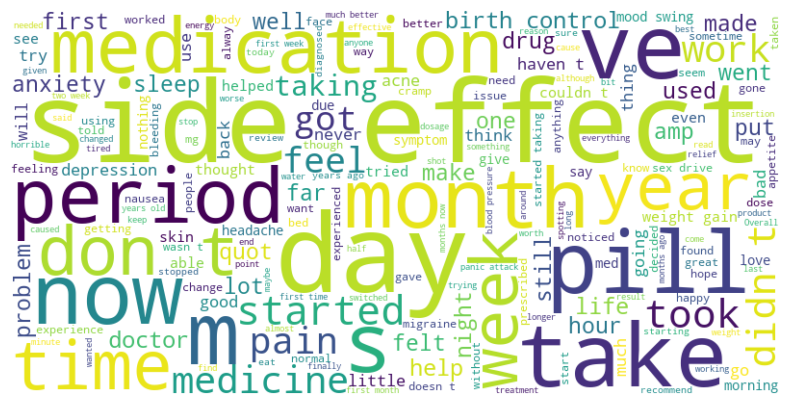

In [207]:
# Plain Vanilla World Cloud Generation based on the frequency of each word even without text preprocessing. 
from wordcloud import WordCloud
import matplotlib.pyplot as plt

text = ' '.join(df['review'].dropna().values)
wordcloud = WordCloud(width=800, height=400, background_color='white', collocations=True).generate(text)

plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.show()


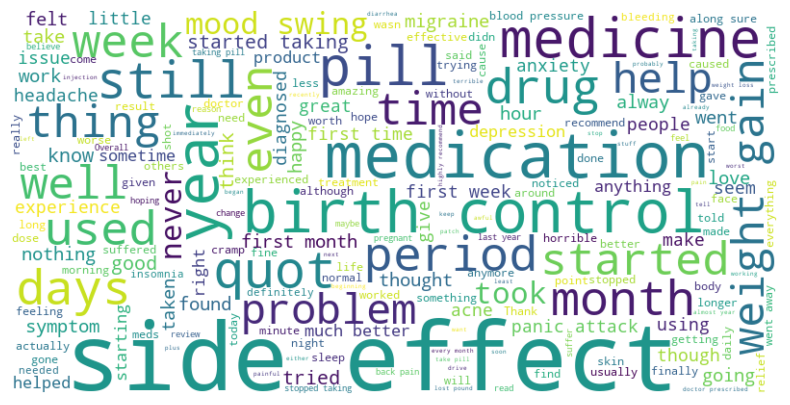

In [208]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt

# Added two new parameters such collocations (generate bigrams from text) and min_word_length (minimum number of letters a word to include)
text = ' '.join(df['review'].dropna().values)
wordcloud = WordCloud(width=800, height=400, background_color='white', min_word_length = 4, collocations=True).generate(text)

plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.show()


In [209]:
# Just for Learning
# # import spacy
# # Sample text

# text = "This is the 1st document! It has punctuation, numbers (123), and stop words."

# # # Convert to lowercase
# # text = text.lower()

# # # Remove special characters and punctuation
# text = re.sub(r'[^\w\s]', '', text)

# # Remove numbers
# text = re.sub(r'\d+', '', text)


# # Remove standalone numbers but keep patterns like '1st', '2nd'
# text = re.sub(r'\b\d+\b', '', text)  # Removes standalone numbers

# # Alternatively, remove only non-alphabetic characters except specific patterns (doesnt work only removes expressions)
# text_after = re.sub(r'[^a-zA-Z0-9\s]', '', text)  # Keeps "1st" as "1st"

# print(text)
# print(text_after)
# # # Remove stop words
# # stop_words = set(stopwords.words('english'))
# # tokens = word_tokenize(text)
# # # tokens = [word for word in tokens if word not in stop_words]

# # print(tokens)
# # # # Lemmatize tokens
# # lemmatizer = WordNetLemmatizer()
# # # print(lemmatizer.lemmatize(tokens))

# # tokens = [lemmatizer.lemmatize(token) for token in tokens]
# # print(tokens)

# # # Join tokens back into a single string
# # preprocessed_text = ' '.join(tokens)
# # print(preprocessed_text)


In [210]:
# Just for learning (Depending on the task we can use stopwords.)
# text =  "It has no taste at all" 

# def preprocess_text(s):
#     s = s.lower()
#     s = re.sub(r'[^a-zA-Z0-9\s]', '', s)
    
#     # Stop word can lead to unanted impact on the sentiment analysis, and need to be taken care of, for ex: "no" is a stopword, lol imagine using sentiment analysis and removing "no"
#     # 'It has no taste at all' vs 'taste' changes the sentiment
#     # stop_words = set(stopwords.words('english'))
    
#     tokens = word_tokenize(s)

#     tokens = [word for word in tokens if word not in stop_words]

#     # Lemmatize tokens
#     lemmatizer = WordNetLemmatizer()
#     tokens = [lemmatizer.lemmatize(token) for token in tokens]

#     # print(tokens)
#     # Join tokens back into a single string
#     prepro_text = ' '.join(tokens)
#     # print(preprocessed_text)
#     return prepro_text

# preprocess_text(text)

### Preprocessing (lowercase, regular-expression removal, stopwords, lemmitization)

#### Preprocessing Using NLTK

In [211]:
import re
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer

def preprocess_text_nltk(s, stop=False, lemmer=True):
    """
    Preprocesses a given text string by converting to lowercase, removing special characters,
    tokenizing, optionally removing stop words, and optionally lemmatizing the tokens.

    Parameters:
    s (str): The input text string to be preprocessed.
    stop (bool): If True, stop words will be removed from the token list. Default is False.
    lemmer (bool): If True, tokens will be lemmatized. Default is True.

    Returns:
    str: The preprocessed text string.
    """
    
    # Convert the input text to lowercase
    s = s.lower()
    
    # Remove standalone numbers (e.g., '5') but keep numbers within words (e.g., '5g')
    s = re.sub(r'\b\d+\b', '', s)
    
    # Remove special characters, keeping only alphanumeric characters and spaces
    s = re.sub(r'[^a-zA-Z0-9\s]', '', s)
    
    # Remove any extra whitespace (including newlines /n)
    s = re.sub(r'\s+', ' ', s).strip()
    
    # Tokenize the text into individual words
    tokens = word_tokenize(s)
    
    # If stop word removal is specified, remove stop words from the token list
    if stop:
        stop_words = set(stopwords.words('english'))
        tokens = [word for word in tokens if word not in stop_words]
    
    # If lemmatization is specified, lemmatize each token
    if lemmer:
        lemmatizer = WordNetLemmatizer()
        tokens = [lemmatizer.lemmatize(token) for token in tokens]
    
    # print(tokens)

    # Join the tokens back into a single string
    prepro_text = ' '.join(tokens)
    
    # Return the preprocessed text
    return prepro_text

In [212]:
# Lets test it
text= 'I was on Zoloft and Clonidine when I first started Abilify at the/m/r/n age of 15mg.'
# text='I d get it remove \r\n'
preprocess_text_nltk(text)
# Remove any extra whitespace (including newlines)
# s = re.sub(r'\s+', ' ', t).strip()
# print(s)

'i wa on zoloft and clonidine when i first started abilify at themrn age of 15mg'

In [213]:
df_nltk = df.copy() # Create a copy of df to preprocess text in the copied one
df_nltk['review'] = df_nltk['review'].apply(lambda x: preprocess_text_nltk(x, lemmer=True))
# pd.set_option('display.max_colwidth', None) # To observe the full column width

In [214]:
# Just manual interspection of data after analysis
# l = df_nltk['review'].count()
# for i in range(int(l/2)):
#     print(df_nltk["review"][i])


####  Preprocessing using Spacy (as it more efficient and up-to-date)

In [215]:
import spacy 

# Load spaCy model
nlp = spacy.load('en_core_web_sm')

def preprocess_text_spacy(s, stop=False, lemmer=True):
    # Convert the input text to lowercase
    s = s.lower()
    # Remove standalone numbers
    s = re.sub(r'\b\d+\b', '', s)
    # Remove special characters, keeping only alphanumeric characters and spaces
    s = re.sub(r'[^a-zA-Z0-9\s]', '', s)

    #  Remove any extra whitespace (including newlines /n)
    s = re.sub(r'\s+', ' ', s).strip()
    
    # Process the text with spaCy
    spacy_doc = nlp(s)
    
    tokens = []
    for token in spacy_doc:
        
        if stop and token.is_stop:
            continue
        if lemmer:
            tokens.append(token.lemma_)
        else:
            tokens.append(token.text)
        
    # print(tokens)
    # Join tokens back into a single string
    prepro_text = ' '.join(tokens)
    return prepro_text


Using spacy's nlp.pipe method for batch processing of multiple documents.

In [216]:
def preprocess_text_spacy_pipe(text, stop=False, lemmer=True):

    clean_text = []
    
    # for text in texts:
       
        # Convert the input text to lowercase
    text  = text.lower()
    # Remove standalone numbers
    text = re.sub(r'\b\d+\b', '', text)
    # Remove special characters, keeping only alphanumeric characters and spaces
    text = re.sub(r'[^a-zA-Z0-9\s]', '', text)

    #  Remove any extra whitespace (including newlines /n)
    text = re.sub(r'\s+', ' ', text).strip()

    clean_text.append(text)

    
    # Process the text with spaCy
    # spacy_doc = nlp(text)
    # print(clean_text)
    for doc in nlp.pipe(clean_text, batch_size=100):
       tokens = []
    #    print(doc)
       for token in doc:
            if stop and token.is_stop:
                continue
            if lemmer:
                tokens.append(token.lemma_)
            else:
                tokens.append(token.text)
        
    # print(tokens)
    # Join tokens back into a single string
    prepro_text = ' '.join(tokens)
    return prepro_text


In [217]:
# commented to avoid running again after kernel restart due to time intensive task
df_spacy = df.copy()
# df_spacy['prep_review'] = df_spacy['review'].apply(lambda x: preprocess_text_spacy(x, lemmer=True))


The time taken by nlp.pipe process is similar, we will need modify the process to utilize parallel processing and creating chunks for expected efficient preprocessing using spacy.

In [218]:
# df_spacy['prep_review_pipe'] = df_spacy['review'].apply(lambda x: preprocess_text_spacy_pipe(x, lemmer=True))

In [219]:
# Also added the stopword column if required later.
# df_spacy['prep_review_pipe_stpwrds'] = df_spacy['review'].apply(lambda x: preprocess_text_spacy_pipe(x, stop=True, lemmer=True))

In [220]:

# df_spacy.to_csv('/Users/yatharth/Documents/RND4IMPACT/Projects/df_spacy.csv', index = False)  # saved to local to conduct experiments from the preprocessed data


In [221]:
df_spacy = pd.read_csv("/Users/yatharth/Documents/RND4IMPACT/Projects/df_spacy.csv")
# df_spacy.reset_index()   
df_spacy

,drugName,condition,review,rating,date,usefulCount,prep_review_pipe,prep_review_pipe_stpwrds
0,Valsartan,Left Ventricular Dysfunction,"""It has no side effect, I take it in combinati...",9,2012-05-20,27,it have no side effect I take it in combinatio...,effect combination bystolic mg fish oil
1,Guanfacine,ADHD,"""My son is halfway through his fourth week of ...",8,2010-04-27,192,my son be halfway through his fourth week of i...,son halfway fourth week intuniv concerned begi...
2,Lybrel,Birth Control,"""I used to take another oral contraceptive, wh...",5,2009-12-14,17,I use to take another oral contraceptive which...,oral contraceptive pill cycle happy light peri...
3,Ortho Evra,Birth Control,"""This is my first time using any form of birth...",8,2015-11-03,10,this be my first time use any form of birth co...,time form birth control m glad go patch month ...
4,Buprenorphine / naloxone,Opiate Dependence,"""Suboxone has completely turned my life around...",9,2016-11-27,37,suboxone have completely turn my life around I...,suboxone completely turn life feel healthy m e...
...,...,...,...,...,...,...,...,...
161292,Campral,Alcohol Dependence,"""I wrote my first report in Mid-October of 201...",10,2015-05-31,125,I write my first report in midoctober of I hav...,write report midoctober alcohol post reduce do...
161293,Metoclopramide,Nausea/Vomiting,"""I was given this in IV before surgey. I immed...",1,2011-11-01,34,I be give this in iv before surgey I immediate...,give iv surgey immediately anxious sit pa say ...
161294,Orencia,Rheumatoid Arthritis,"""Limited improvement after 4 months, developed...",2,2014-03-15,35,limit improvement after month develop bad rash...,limit improvement month develop bad rash md re...
161295,Thyroid desiccated,Underactive Thyroid,"""I&#039;ve been on thyroid medication 49 years...",10,2015-09-19,79,I ve be on thyroid medication year I spend my ...,ve thyroid medication year spend synthroid t4 ...


In [56]:
# df_spacy = df_spacy.drop(columns= "Unnamed: 0", axis=1)
# df_spacy.columns

#### Word Cloud after Spacy preprocessing

Without Stopwords

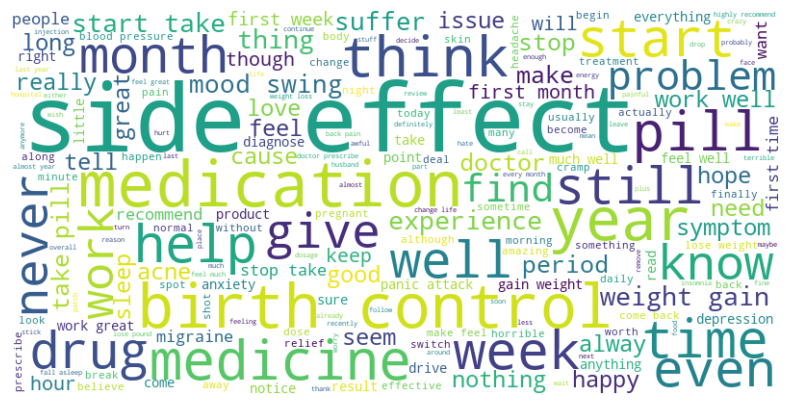

In [228]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt

# Added two new parameters such collocations (generate bigrams from text) and min_word_length (minimum number of letters a word to include)
text = ' '.join(df_spacy['prep_review_pipe'].dropna().values)
wordcloud = WordCloud(width=800, height=400, background_color='white', min_word_length = 4, collocations=True).generate(text)

plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.show()


Using the Stop Word column

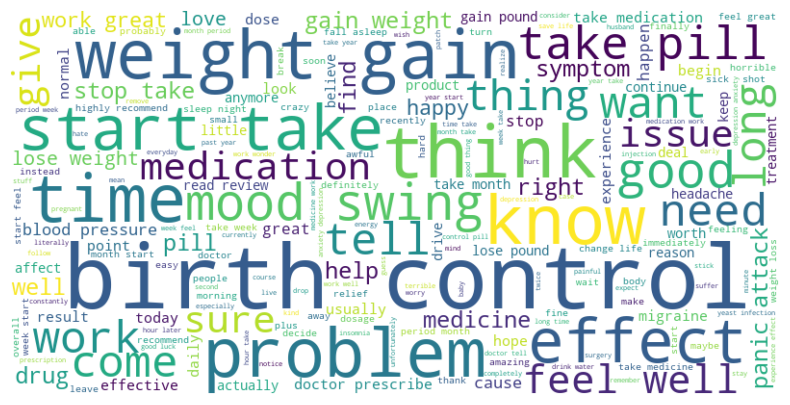

In [229]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt

# Added two new parameters such collocations (generate bigrams from text) and min_word_length (minimum number of letters a word to include)
text = ' '.join(df_spacy['prep_review_pipe_stpwrds'].dropna().values)
wordcloud = WordCloud(width=800, height=400, background_color='white', min_word_length = 4, collocations=True).generate(text)

plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.show()


---

#### Lets group by reviews, and check the count to see the top 20 repeated comments:

In [230]:
review_count = df_spacy['prep_review_pipe'].value_counts(normalize=True).reset_index()

In [231]:
sorted_review_count  = review_count.sort_values(by = 'proportion', ascending= False)
sorted_review_count[:21]

,prep_review_pipe,proportion
0,good,0.000378
1,great,0.000279
2,work great,0.000273
3,very good,0.000174
4,work well,0.000161
5,it work,0.000161
6,excellent,0.000130
7,do not work,0.000099
8,do not work at all,0.000087
9,save my life,0.000087


Top 20 Repeated Reviews with Counts and Proportions:
                    count  proportion
prep_review_pipe                     
good                   61    0.000378
great                  45    0.000279
work great             44    0.000273
very good              28    0.000174
work well              26    0.000161
it work                26    0.000161
excellent              21    0.000130
do not work            16    0.000099
do not work at all     14    0.000087
save my life           14    0.000087
I love it              11    0.000068
good medicine          11    0.000068
work                   10    0.000062
love it                10    0.000062
work for I             10    0.000062
awesome                10    0.000062
do not work for I       9    0.000056
no side effect          9    0.000056
very effective          9    0.000056
work very well          9    0.000056


/var/folders/qf/skvw9ygx6hnddqy1kk2pswtc0000gn/T/ipykernel_33471/1327974953.py:21: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`



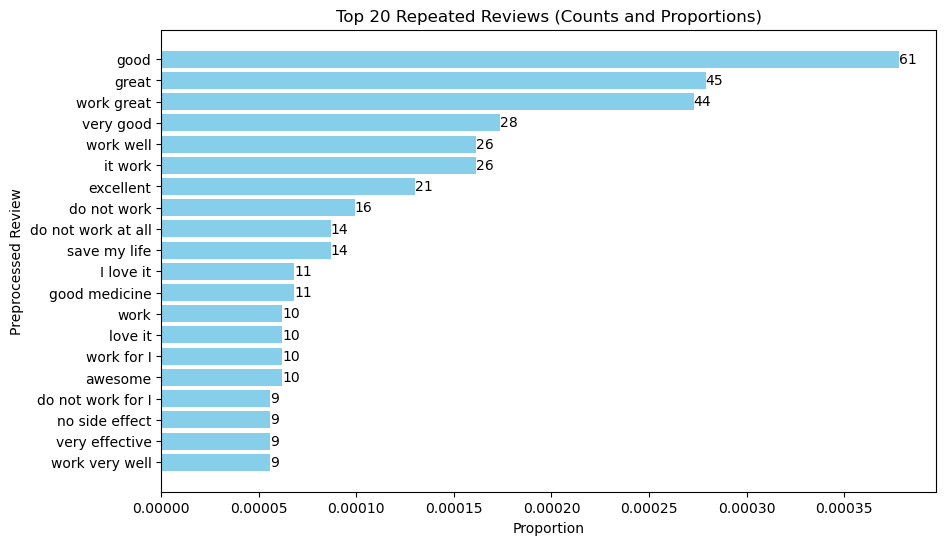

In [232]:
import matplotlib.pyplot as plt
# Calculate value counts and proportions
value_counts = df_spacy['prep_review_pipe'].value_counts()
proportions = df_spacy['prep_review_pipe'].value_counts(normalize=True)

# Combine counts and proportions into a single DataFrame
combined_df = pd.DataFrame({'count': value_counts, 'proportion': proportions})

# Sort by count for better presentation
combined_df = combined_df.sort_values(by='count', ascending=False)

# Display the top 20 repeated reviews with counts and proportions
top_20_combined_df = combined_df.head(20)
print("Top 20 Repeated Reviews with Counts and Proportions:")
print(top_20_combined_df)

# Visualization
plt.figure(figsize=(10, 6))
plt.barh(top_20_combined_df.index, top_20_combined_df['proportion'], color='skyblue')
for index, value in enumerate(top_20_combined_df['count']):
    plt.text(top_20_combined_df['proportion'][index], index, f'{value}', va='center')

plt.xlabel('Proportion')
plt.ylabel('Preprocessed Review')
plt.title('Top 20 Repeated Reviews (Counts and Proportions)')
plt.gca().invert_yaxis()
plt.show()

Using Plotly

In [233]:
import plotly.graph_objects as go

# Visualization with Plotly
fig = go.Figure()

# Add bars for proportions
fig.add_trace(go.Bar(
    y=top_20_combined_df.index,
    x=top_20_combined_df['proportion'],
    orientation='h',
    marker=dict(color='skyblue'),
    text=top_20_combined_df['count'],  # Annotate with raw counts
    textposition='auto',
    hovertemplate='<b>%{y}</b><br>Proportion: %{x:.6f}<br>Count: %{text}<extra></extra>'
))

# Update layout for better appearance
fig.update_layout(
    title='Top 20 Repeated Reviews (Counts and Proportions)',
    xaxis_title='Proportion',
    yaxis_title='Preprocessed Review',
    yaxis=dict(autorange='reversed'),  # Reverse the y-axis to have the highest count on top
    margin=dict(l=200),  # Adjust left margin to fit long labels
    height=600
)

fig.show()

The above graph showcases a majority positive sentiment in the TOP 20 repeated reviews.

Initially, lets create a word cloud, using the word frequency of the cloud generator, and then we will use the collocations as True feature to include bigrams in the word cloud which are frequent in the text. Further after preprocessing using Spacy, and using lemmitization, we have the preprocessed text on which we generate the collocations enabled word cloud to observe a better visualization of the review column.
In the next method of analysis, we focus on applying TF-IDF to preprocessed reviews, 'prep_review_pipe', and then generate the word cloud based on the most inportant words as per TF-IDF. Using collocations here won't work, as tf-idf will be dictionary having the importance score for each word. And in addition to this we apply stop word removal to this word cloud generation, as the word cloud is just based on tf-idf and stop words won't addd any value to the analysis.

Then further we apply the POS tag removal as a part of spacy pipeline to further refine the text by removing insignificant english grammar nuances to get more meaningful words and then generate tf-idf based word cloud on 'custom_prep_review_pos'.

Now, further we will create bigrams, and then use tf-idf to create bigram based word cloud, which might give us more insisghts into the reviews without using stop words as for bigrams stopwords can matter to showcase context.

### TF-IDF 

In [234]:
from sklearn.feature_extraction.text import TfidfVectorizer
import numpy as np



# review =  df_spacy['prep_review_pipe'].dropna().values

# Initialize the TF-IDF vectorizer with max_features parameter
# tfidf_vectorizer = TfidfVectorizer(stop_words='english')

# # # Fit and transform the reviews
# tfidf_matrix = tfidf_vectorizer.fit_transform(review)

# # Get the feature names (words)
# feature_names = tfidf_vectorizer.get_feature_names_out()

# # # Convert to a DataFrame for better visualization
# tfidf_df = pd.DataFrame(tfidf_matrix.toarray(), columns=feature_names)
# computationally expensive to take the transpose here as rows ~170K
# tf = tfidf_df.T.sum(axis=1)
# stf = tf.sort_values(ascending=False)


In [235]:
# Sum the TF-IDF scores across all documents for each term directly on the sparse matrix
# tfidf_sum = np.array(tfidf_matrix.sum(axis=0)).flatten()

# # # Get the feature names (words)
# feature_names = tfidf_vectorizer.get_feature_names_out()

# # Create a DataFrame to visualize the summed TF-IDF scores
# tfidf_sum_df = pd.DataFrame({'term': feature_names, 'tfidf_sum': tfidf_sum})


In [236]:
def tf_idf(df):

    review  = df.dropna().values

    # Initialize the TF-IDF vectorizer with max_features parameter
    tfidf_vectorizer = TfidfVectorizer(stop_words='english')

    # # Fit and transform the reviews
    tfidf_matrix = tfidf_vectorizer.fit_transform(review)

    # Sum the TF-IDF scores across all documents for each term directly on the sparse matrix
    tfidf_sum = np.array(tfidf_matrix.sum(axis=0)).flatten()

    # # Get the feature names (words)
    feature_names = tfidf_vectorizer.get_feature_names_out()

    # Create a DataFrame to visualize the summed TF-IDF scores
    tfidf_sum_df = pd.DataFrame({'term': feature_names, 'tfidf_sum': tfidf_sum})

    stf = tfidf_sum_df.sort_values(by ='tfidf_sum',ascending=False)

    # Convert terms and their summed TF-IDF scores into a dictionary
    tfidf_dict = dict(zip(stf['term'], stf['tfidf_sum']))

    return tfidf_dict
    

In [240]:
tfidf_dict = tf_idf(df_spacy['prep_review_pipe'])
tfidf_dict_stpwrds = tf_idf(df_spacy['prep_review_pipe_stpwrds'])

In [238]:
tfidf_dict

{'day': 5765.393533498587,
 'work': 5006.587998470115,
 'month': 4758.214197110966,
 'feel': 4623.654224073808,
 'year': 4392.960171407712,
 'effect': 4186.7580037465195,
 'pain': 4173.9456172128275,
 'week': 4141.4743229917085,
 'start': 3918.491469054908,
 've': 3856.153149214517,
 'pill': 3659.6232577213304,
 'time': 3646.097579771066,
 'period': 3642.2483322072244,
 'mg': 3525.9841081543,
 'use': 3355.378002441992,
 'bad': 3342.391542037016,
 'help': 3250.9973441474203,
 'like': 3215.877157418204,
 'just': 3088.9535906893134,
 'medication': 3032.4409874863677,
 'make': 2987.871765380523,
 'good': 2882.422062698471,
 'try': 2845.72472300052,
 'medicine': 2824.4514116650134,
 'weight': 2621.9522225566893,
 'doctor': 2567.015033493316,
 'sleep': 2437.6803152201733,
 'great': 2400.8870208778058,
 'anxiety': 2371.4915628912745,
 'really': 2364.340353444743,
 'life': 2356.532694748081,
 'stop': 2326.776907399137,
 'experience': 2322.5054221006617,
 'control': 2291.479120025328,
 'gain': 

#### TF-IDF based Word Cloud

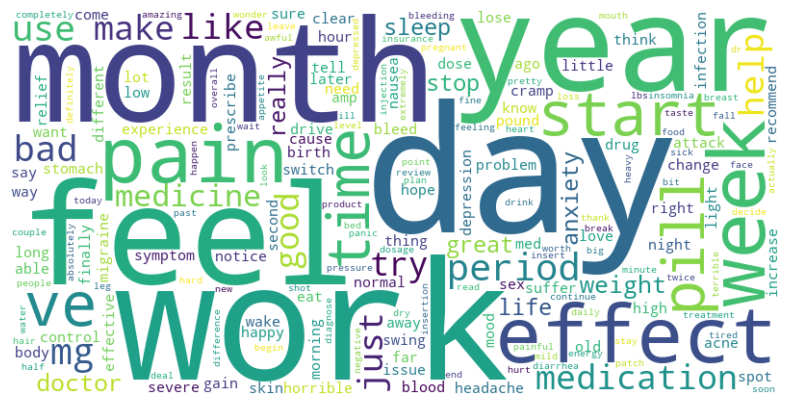

In [241]:
# Added two new parameters such collocations (generate bigrams from text) and min_word_length (minimum number of letters a word to include)
# Collocations: Not applicable, as TF-IDF scores are calculated for individual words here.

wordcloud = WordCloud(width=800, height=400, background_color='white', min_word_length = 4).generate_from_frequencies(tfidf_dict)

plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.show()

With Stop words: (Observing some redudnant words which focus on time have been removed.)

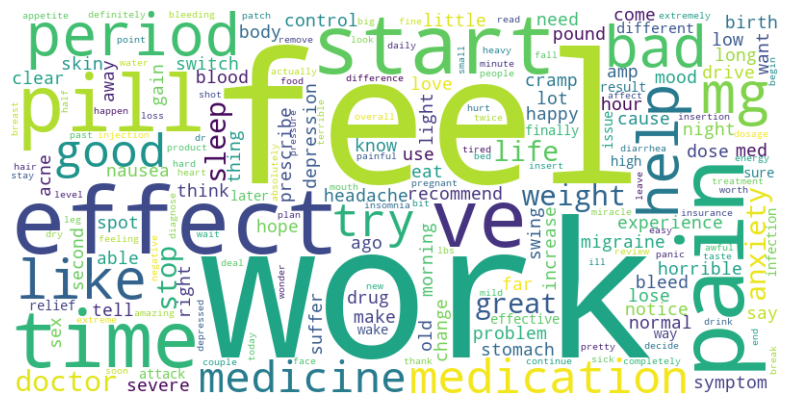

In [243]:
# Creating Word Cloud filtering stop words and few words which dont add significant meaning
# from wordcloud import WordCloud, STOPWORDS

# # Define stopwords
# default_stop_words = set(stopwords.words('english')).union(set(STOPWORDS))

# Add custom stopwords
custom_stop_words = set(["day", "week", "month", "year"]) #time focused words


# Filter the TF-IDF dictionary (Removing the Stop Words)
filtered_tfidf_dict = {word: score for word, score in tfidf_dict_stpwrds.items() if word not in custom_stop_words}

# Generate word cloud
wordcloud = WordCloud(width=800, height=400, background_color='white', min_word_length=4).generate_from_frequencies(filtered_tfidf_dict)
plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.show()

#### Idea to further preprocess review column on the basis of Spacy's POS (Part-of-Speech Tagging)

The most interesting component in the pipeline is the tagger which assigns Part-Of-Speech (POS) tags based on SpaCy's English language model to gain a variety of annotations. A POS tag (or part-of-speech tag) is a special label assigned to each token in a text corpus to indicate the type of token (is it an adjective? Punctuation? A verb? etc.) and often also other grammatical categories such as tense, number (plural/singular), symbols etc. POS tags are used in corpus searches and in-text analysis tools and algorithms. Uses linguistic features to identify and remove words based on their grammatical roles.

- We can use the POS tags to preprocess the data by removing unwanted tags. For ex: Assuming we want to remove all numbers in our text, we can then point at a specific tag and remove it.

Purpose:

- To remove words based on their part of speech, which can help refine the text by focusing on more informative word types.

Typical POS Tags Removed:

- Adverbs (ADV), Pronouns (PRON), Conjunctions (CCONJ), Punctuation (PUNCT), Particles (PART), Determiners (DET), Adpositions (ADP), Spaces (SPACE), Symbols (SYM), etc.

In [303]:
import spacy
nlp = spacy.load('en_core_web_sm')

In [245]:
# Tags I want to remove from the text
removal= ['ADV','PRON','CCONJ','PUNCT','PART','DET','ADP','SPACE', 'SYM']
# tokens = []
# for doc in nlp.pipe(df_spacy['prep_review_pipe'].fillna('').astype(str)):
#    # print(doc)
#    proj_tok = [token.text for token in doc if token.pos_ not in removal]
#    # print(tokens)
#    tokens.append(' '.join(proj_tok))

In [250]:
df_spacy.columns

Index(['drugName', 'condition', 'review', 'rating', 'date', 'usefulCount',
       'prep_review_pipe', 'prep_review_pipe_stpwrds'],
      dtype='object')

In [251]:
# Remove specified POS tags and create a column with joined tokens and a column with token lists
def remove_pos_tags(texts, removal):
    cleaned_tokens = []
    cleaned_joined = []
    for doc in nlp.pipe(texts, batch_size=100):
        tokens = [token.text for token in doc if token.pos_ not in removal]
        cleaned_tokens.append(tokens)
        cleaned_joined.append(' '.join(tokens))
    return cleaned_tokens, cleaned_joined

# Apply POS tag removal on stopwords preprocessed, i.e., prep_review_pipe_stpwrds
df_spacy['custom_prep_review_pos_tokens'], df_spacy['custom_prep_review_pos'] = remove_pos_tags(df_spacy['prep_review_pipe_stpwrds'].fillna('').astype(str), removal)


In [253]:
df_spacy['custom_prep_review_pos']


0                      effect combination bystolic fish oil
1         son fourth week intuniv concerned begin week s...
2         oral contraceptive pill cycle happy light peri...
3         time form birth control m glad go patch month ...
4         suboxone turn life feel healthy m excel job mo...
                                ...                        
161292    write report midoctober alcohol post reduce do...
161293    give surgey anxious sit pa say quotoh yes happ...
161294    limit improvement month develop bad rash md re...
161295    ve thyroid medication year spend synthroid t4 ...
161296    ve chronic constipation adult life try linzess...
Name: custom_prep_review_pos, Length: 161297, dtype: object

Word Cloud based on TF-IDF, STOP WORD Removal, and POS tag removal (To further narrow down the focus to meaninngful words in the reviews)

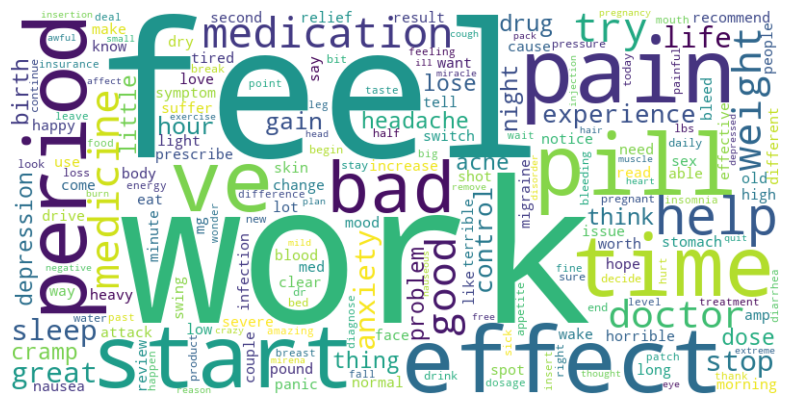

In [256]:
# Word cloud after removing certain pos tags:
tfidf_dict_pos = tf_idf(df_spacy['custom_prep_review_pos'])

# Define stopwords
# default_stop_words = set(stopwords.words('english')).union(set(STOPWORDS))

# Add custom stopwords
custom_stop_words = set(["day", "week", "month", "year"])
# stop_words = default_stop_words.union(custom_stop_words)

# Filter the TF-IDF dictionary
filtered_tfidf_dict = {word: score for word, score in tfidf_dict_pos.items() if word not in custom_stop_words}

# Generate word cloud
wordcloud = WordCloud(width=800, height=400, background_color='white',
                       min_word_length=4).generate_from_frequencies(filtered_tfidf_dict)
plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.show()

---

---

##### Trying topic modeling on reviews:

In [99]:
# Just realized that we need to run stop words before topic modeling.
stop_words = set(stopwords.words('english'))

# Function to remove stop words from tokens
def remove_stop_words(tokens):
    return [word for word in tokens if word not in stop_words]

# Apply stop word removal
df_spacy['tm_tokens'] = df_spacy['custom_pre_review_pos_tokens'].apply(remove_stop_words)


In [100]:
# Create Dictionary and Corpus
id2word = corpora.Dictionary(df_spacy['tm_tokens'])
corpus = [id2word.doc2bow(text) for text in df_spacy['tm_tokens']]

# Build LDA model
lda_model = LdaModel(corpus=corpus,
                     id2word=id2word,
                     num_topics=3,  # Choose the number of topics
                     random_state=42,
                     update_every=1,
                     chunksize=10,
                     passes=10,
                     alpha='auto',
                     per_word_topics=True)

# Print the topics
for idx, topic in lda_model.print_topics(-1):
    print('Topic: {} \nWords: {}'.format(idx, topic))



Topic: 0 
Words: 0.031*"take" + 0.018*"feel" + 0.017*"day" + 0.016*"effect" + 0.016*"side" + 0.015*"year" + 0.014*"work" + 0.013*"start" + 0.013*"week" + 0.012*"go"
Topic: 1 
Words: 0.034*"period" + 0.030*"get" + 0.029*"month" + 0.022*"pill" + 0.019*"control" + 0.017*"day" + 0.017*"week" + 0.014*"birth" + 0.012*"acne" + 0.012*"start"
Topic: 2 
Words: 0.038*"pain" + 0.022*"day" + 0.020*"take" + 0.015*"use" + 0.012*"get" + 0.012*"go" + 0.011*"bad" + 0.010*"work" + 0.009*"hour" + 0.008*"time"


In [101]:
# Visualize the topics
import pyLDAvis
import pyLDAvis.gensim_models as gensimvis

pyLDAvis.enable_notebook()
vis = gensimvis.prepare(lda_model, corpus, id2word)
pyLDAvis.display(vis)

python(80650) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(80651) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(80652) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(80653) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(80654) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(80655) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(80656) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(80657) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(80658) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(80659) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(80660) Malloc

Summary:

Topic 1: "General Medication Experiences"

Focuses on the overall experiences, effects, and duration of medication use.

Topic 2: "Pain Management"

Deals with issues related to pain, its management, and the effectiveness of pain relief methods.

Topic 3: "Birth Control and Menstrual Cycle"

Centers on discussions about birth control, menstrual cycles, and related effects.

Topic 2 and 3 seem more accurate as the moajority conditions reveiewed in dataset are of the **Birth Control**, **Depression** and **Pain**

---

#### Word Cloud for Top 3 Reviewed Drugs and Conditions (8 Conditions in this case, for ex., Birth Control, Menstural Disorders, Acne, etc.)

In [114]:
drug_count = df_spacy["drugName"].value_counts().reset_index()
drug_count = drug_count[:3]
drug_count.columns = ['drug','count']

In [130]:
top_3_drug_reviews = df_spacy.loc[df_spacy["drugName"].isin(drug_count['drug'])]
top_3_drug_reviews
top_3_drug_reviews["condition"] = top_3_drug_reviews["condition"].loc[top_3_drug_reviews["condition"]!= 'Not Listed / Othe']
top_conditions = top_3_drug_reviews["condition"].value_counts().index


/var/folders/qf/skvw9ygx6hnddqy1kk2pswtc0000gn/T/ipykernel_33471/117766898.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [139]:
top_conditions

Index(['Birth Control', 'Emergency Contraception', 'Abnormal Uterine Bleeding',
       'Acne', 'Menstrual Disorders', 'Polycystic Ovary Syndrome',
       'Endometriosis', 'Postmenopausal Symptoms'],
      dtype='object', name='condition')

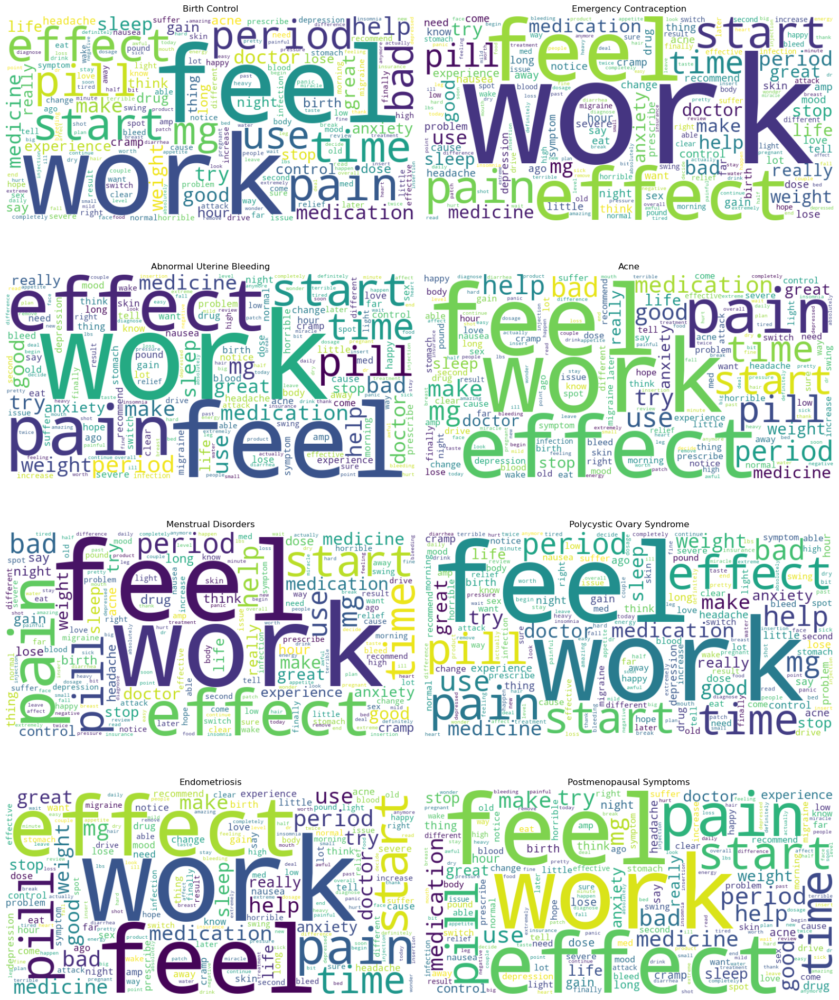

In [134]:
# Word cloud after removing certain pos tags:
# tfidf_dict_pos = tf_idf(top_20_drug_reviews['custom_pre_review_pos'])

# Define stopwords
default_stop_words = set(stopwords.words('english')).union(set(STOPWORDS))

# Add custom stopwords
custom_stop_words = set(["day", "week", "month", "year"])
stop_words = default_stop_words.union(custom_stop_words)

# Filter the TF-IDF dictionary
# filtered_tfidf_dict = {word: score for word, score in tfidf_dict.items() if word not in stop_words}

# Create word clouds for each top condition
fig, axes = plt.subplots(4, 2, figsize=(16, 20))  # Adjust number of rows and columns as needed
axes = axes.flatten()

for i, condition in enumerate(top_conditions):
    condition_reviews = top_3_drug_reviews[top_3_drug_reviews['condition'] == condition]['custom_pre_review_pos']
    tfidf_dict_pos = tf_idf(top_3_drug_reviews['custom_pre_review_pos'])
    filtered_tfidf_dict = {word: score for word, score in tfidf_dict.items() if word not in stop_words}

    
    wordcloud = WordCloud(width=800, height=400, background_color='white', stopwords=stop_words).generate_from_frequencies(filtered_tfidf_dict)
    
    axes[i].imshow(wordcloud, interpolation='bilinear')
    axes[i].set_title(condition)
    axes[i].axis('off')

plt.tight_layout()
plt.show()

---

---

In [ ]:
# Just a very basic approach to sentiment analysis
from textblob import TextBlob

# Define the sentiment classification function
def classify_sentiment(polarity):
    if polarity > 0.1:  # Adjust threshold as needed
        return 'pos'
    elif polarity < -0.1:
        return 'neg'
    else:
        return 'neu'
    
df['polarity'] = df['review'].apply(lambda x: TextBlob(x).sentiment.polarity)

# Apply the classification function
df['sentiment'] = df['polarity'].apply(classify_sentiment)

In [ ]:
pd.set_option('display.max_colwidth', None)
print(df[['review', 'sentiment']].head(10))



                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                  review  \
0                                                                                                                                                                                                                                           

In [ ]:
# In addition, I plotted histograms of drug names and condition distribution but due to the large number of drugs present in the column, I strategized to create a Top 20 drug analysis and Top 20 condition analysis to understand the most reviewed drug and condition in the dataset.